<a href="https://colab.research.google.com/github/MariaKhan28981/UIDAI-hackathon-project/blob/main/AadharDataAnalysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns


In [ ]:
from google.colab import files

In [ ]:
files.upload()

Saving api_data_aadhar_enrolment.zip to api_data_aadhar_enrolment.zip


{'api_data_aadhar_enrolment.zip': b'PK\x03\x04\x14\x00\x00\x00\x00\x00az!\\\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x1a\x00 \x00api_data_aadhar_enrolment/ux\x0b\x00\x01\x04\x00\x00\x00\x00\x04\x00\x00\x00\x00UT\r\x00\x07\x0fCVi\x19CVi\x08CViPK\x03\x04\x14\x00\x08\x00\x08\x00\xa6x!\\\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00@\x00 \x00api_data_aadhar_enrolment/api_data_aadhar_enrolment_0_500000.csvux\x0b\x00\x01\x04\x00\x00\x00\x00\x04\x00\x00\x00\x00UT\r\x00\x07\xd0?Vi\xd0?Vi\xd0?Vi\x9c\xbd\xdb\x92$\xc7\x91$\xfa~D\xce?\xf4\xe3\x8cH\xceH\xf8-.\x8f\xdd\xc0\x0c\xb0h\x02\x0bA\x83\x1c\xd9\xf32\x92\xcd\xaa\xedJt] U\x95\x80\x90_\x7f\\\xd5"3#\xdc\xcc=\xb2f\x85K\x82\x9c\xcc\xca\x08\xbf\xd8EMM\xedf\xffz\xbb{y\xc5\xbf\xdf\x1c^^\x9f\x0f\x7f\x7f\xdd\xfd~x\xfc\xfb\xd3\xcd\xedn\xff\xe5\xf6\xbf\xbb\xffN\xfc\xcf\xf4\xdfn\xe0?\xb8\xf1\xbf\xbf<\xdf\xe6\xcf?\xff\xbf\xffO\xe7\xff\xad\x0b\xff\xe6;\x9fv?\xde~\xb9\xdb\xdf\xef\xff\xb1\xdf\xfd\xc7\xfe\xe5\xf5\xdd\xc7\xbb\xfd\xcb\xe1\xdd\xf7\x87\xfb

In [ ]:
!unzip /content/api_data_aadhar_enrolment.zip

Archive:  /content/api_data_aadhar_enrolment.zip
   creating: api_data_aadhar_enrolment/
  inflating: api_data_aadhar_enrolment/api_data_aadhar_enrolment_0_500000.csv  
  inflating: api_data_aadhar_enrolment/api_data_aadhar_enrolment_1000000_1006029.csv  
  inflating: api_data_aadhar_enrolment/api_data_aadhar_enrolment_500000_1000000.csv  


In [ ]:

df = pd.read_csv('api_data_aadhar_enrolment/api_data_aadhar_enrolment_0_500000.csv')
display(df.head())

,date,state,district,pincode,age_0_5,age_5_17,age_18_greater
0,02-03-2025,Meghalaya,East Khasi Hills,793121,11,61,37
1,09-03-2025,Karnataka,Bengaluru Urban,560043,14,33,39
2,09-03-2025,Uttar Pradesh,Kanpur Nagar,208001,29,82,12
3,09-03-2025,Uttar Pradesh,Aligarh,202133,62,29,15
4,09-03-2025,Karnataka,Bengaluru Urban,560016,14,16,21


In [ ]:
df.columns

Index(['date', 'state', 'district', 'pincode', 'age_0_5', 'age_5_17',
       'age_18_greater'],
      dtype='object')

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 500000 entries, 0 to 499999
Data columns (total 7 columns):
 #   Column          Non-Null Count   Dtype 
---  ------          --------------   ----- 
 0   date            500000 non-null  object
 1   state           500000 non-null  object
 2   district        500000 non-null  object
 3   pincode         500000 non-null  int64 
 4   age_0_5         500000 non-null  int64 
 5   age_5_17        500000 non-null  int64 
 6   age_18_greater  500000 non-null  int64 
dtypes: int64(4), object(3)
memory usage: 26.7+ MB


In [ ]:
df.describe()

,pincode,age_0_5,age_5_17,age_18_greater
count,500000.000000,500000.000000,500000.000000,500000.000000
mean,519204.051054,4.040812,2.315682,0.245558
std,206793.322085,24.417921,20.191196,4.438557
min,100000.000000,0.000000,0.000000,0.000000
25%,362229.000000,1.000000,0.000000,0.000000
50%,517131.000000,2.000000,0.000000,0.000000
75%,712139.000000,3.000000,1.000000,0.000000
max,855456.000000,2688.000000,1812.000000,855.000000


In [ ]:
print(f"Total number of distinct states: {df['state'].nunique()}")
print("Unique states :")
display(df['state'].value_counts())


Total number of distinct states: 54
Unique states :


,count
state,
Uttar Pradesh,57240
Tamil Nadu,45087
West Bengal,39965
Maharashtra,38194
Karnataka,33626
Andhra Pradesh,31469
Bihar,30626
Rajasthan,28408
Madhya Pradesh,24323


In [ ]:
import re

def clean_string(text):
    if isinstance(text, str):
        text = text.lower().strip()
        text = re.sub(r'\s+', ' ', text) # Replace multiple spaces with a single space
        text = re.sub(r'[^a-z0-9 ]', '', text) # Remove non-alphanumeric characters except spaces
        return text
    return None

print("Defined the clean_string function.")

Defined the clean_string function.


In [ ]:
df['state'] = df['state'].apply(clean_string)
print("Applied clean_string function to 'state' columns.")

Applied clean_string function to 'state' columns.


In [ ]:
df['state'] = df['state'].replace([
    'westbengal', 'west bangal', 'west bengal'
], 'west bengal')

df['state'] = df['state'].replace([
    'orissa'
], 'odisha')

df['state'] = df['state'].replace([
    'andhrapradesh'
], 'andhra pradesh')

df['state'] = df['state'].replace([
    'pondicherry'
], 'puducherry')

df['state'] = df['state'].replace([
    'jammu & kashmir'
], 'jammu and kashmir')

df['state'] = df['state'].replace([
    'dadra & nagar haveli'
], 'dadra and nagar haveli')

df['state'] = df['state'].replace([
    'daman & diu'
], 'daman and diu')

df['state'] = df['state'].replace([
    'andaman & nicobar islands'
], 'andaman and nicobar islands')

df['state'] = df['state'].replace([
    'the dadra and nagar haveli and daman and diu'
], 'dadra and nagar haveli and daman and diu')

df = df[df['state'] != '100000']
print("All specified state variations and anomalous entries standardized and removed.")

All specified state variations and anomalous entries standardized and removed.


In [ ]:
print(f"Total number of distinct states: {df['state'].nunique()}")
print("Unique states :")
display(df['state'].value_counts())


Total number of distinct states: 42
Unique states :


,count
state,
uttar pradesh,57240
tamil nadu,45087
west bengal,39988
maharashtra,38194
karnataka,33626
andhra pradesh,31471
bihar,30626
rajasthan,28408
odisha,24663


In [ ]:
df['date'] = pd.to_datetime(df['date'], format='%d-%m-%Y')
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 499991 entries, 0 to 499999
Data columns (total 7 columns):
 #   Column          Non-Null Count   Dtype         
---  ------          --------------   -----         
 0   date            499991 non-null  datetime64[ns]
 1   state           499991 non-null  object        
 2   district        499991 non-null  object        
 3   pincode         499991 non-null  int64         
 4   age_0_5         499991 non-null  int64         
 5   age_5_17        499991 non-null  int64         
 6   age_18_greater  499991 non-null  int64         
dtypes: datetime64[ns](1), int64(4), object(2)
memory usage: 30.5+ MB


## Calculate Total Enrollments


In [ ]:
df['total_enrollments'] = df['age_0_5'] + df['age_5_17'] + df['age_18_greater']
display(df.head())

,date,state,district,pincode,age_0_5,age_5_17,age_18_greater,total_enrollments
0,2025-03-02,meghalaya,East Khasi Hills,793121,11,61,37,109
1,2025-03-09,karnataka,Bengaluru Urban,560043,14,33,39,86
2,2025-03-09,uttar pradesh,Kanpur Nagar,208001,29,82,12,123
3,2025-03-09,uttar pradesh,Aligarh,202133,62,29,15,106
4,2025-03-09,karnataka,Bengaluru Urban,560016,14,16,21,51


In [ ]:
total_enrollments = df['total_enrollments'].sum()
display(total_enrollments)

np.int64(3301013)

## Analyze Age Group Distribution



In [ ]:
age_group_enrollments = df[['age_0_5', 'age_5_17', 'age_18_greater']].sum()
display(age_group_enrollments)

,0
age_0_5,2020406
age_5_17,1157840
age_18_greater,122767


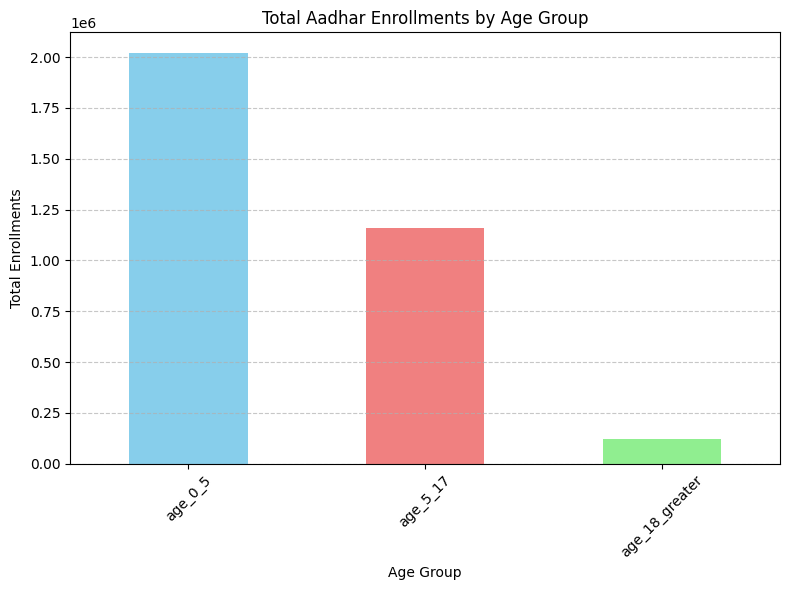

In [ ]:
plt.figure(figsize=(8, 6))
age_group_enrollments.plot(kind='bar', color=['skyblue', 'lightcoral', 'lightgreen'])
plt.title('Total Aadhar Enrollments by Age Group')
plt.xlabel('Age Group')
plt.ylabel('Total Enrollments')
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

## Analyze Temporal Trends

In [ ]:
df['year'] = df['date'].dt.year
df['month'] = df['date'].dt.month
display(df.head())

,date,state,district,pincode,age_0_5,age_5_17,age_18_greater,total_enrollments,year,month
0,2025-03-02,meghalaya,East Khasi Hills,793121,11,61,37,109,2025,3
1,2025-03-09,karnataka,Bengaluru Urban,560043,14,33,39,86,2025,3
2,2025-03-09,uttar pradesh,Kanpur Nagar,208001,29,82,12,123,2025,3
3,2025-03-09,uttar pradesh,Aligarh,202133,62,29,15,106,2025,3
4,2025-03-09,karnataka,Bengaluru Urban,560016,14,16,21,51,2025,3


In [ ]:
monthly_enrollments = df.groupby(['year', 'month'])['total_enrollments'].sum().reset_index()
monthly_enrollments['date'] = pd.to_datetime(monthly_enrollments['year'].astype(str) + '-' + monthly_enrollments['month'].astype(str) + '-01')
monthly_enrollments = monthly_enrollments.sort_values(by='date')
display(monthly_enrollments.head())

,year,month,total_enrollments,date
0,2025,3,16582,2025-03-01
1,2025,4,257438,2025-04-01
2,2025,5,183616,2025-05-01
3,2025,6,215734,2025-06-01
4,2025,7,616868,2025-07-01


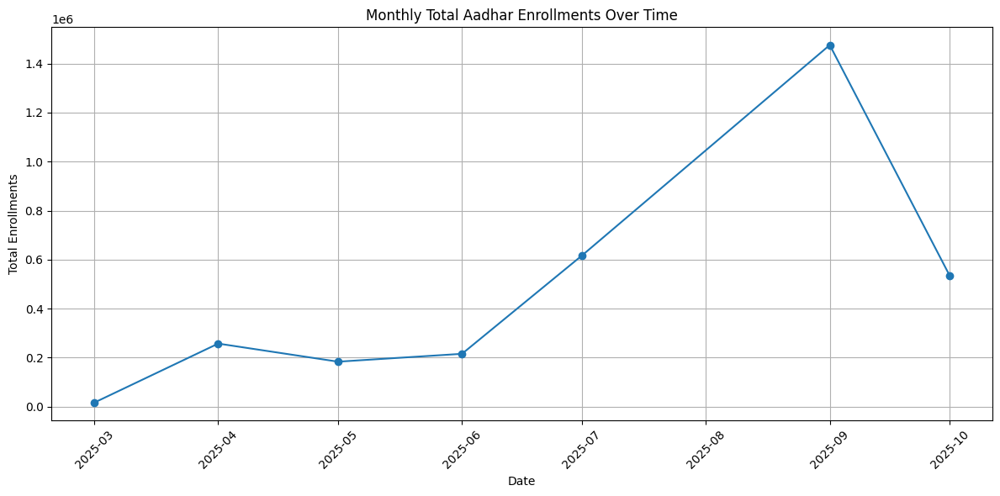

In [ ]:
plt.figure(figsize=(12, 6))
plt.plot(monthly_enrollments['date'], monthly_enrollments['total_enrollments'], marker='o', linestyle='-')
plt.title('Monthly Total Aadhar Enrollments Over Time')
plt.xlabel('Date')
plt.ylabel('Total Enrollments')
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

## Analyze Geographical Distribution (States)




In [ ]:
state_enrollments = df.groupby('state')['total_enrollments'].sum().sort_values(ascending=False)
display(state_enrollments.head())
display(state_enrollments.tail())

,total_enrollments
state,
uttar pradesh,670426
bihar,390901
madhya pradesh,277081
west bengal,222284
maharashtra,222030


,total_enrollments
state,
jammu kashmir,71
andaman nicobar islands,57
daman and diu,42
dadra nagar haveli,13
daman diu,11


In [ ]:
top_10_states = state_enrollments.head(10)
bottom_10_states = state_enrollments.tail(10)

print("Top 10 States by Aadhar Enrollments:")
display(top_10_states)

print("\nBottom 10 States by Aadhar Enrollments:")
display(bottom_10_states)

Top 10 States by Aadhar Enrollments:


,total_enrollments
state,
uttar pradesh,670426
bihar,390901
madhya pradesh,277081
west bengal,222284
maharashtra,222030
rajasthan,205699
gujarat,193313
assam,167163
karnataka,121762



Bottom 10 States by Aadhar Enrollments:


,total_enrollments
state,
dadra and nagar haveli and daman and diu,798
dadra and nagar haveli,436
ladakh,250
andaman and nicobar islands,191
lakshadweep,93
jammu kashmir,71
andaman nicobar islands,57
daman and diu,42
dadra nagar haveli,13


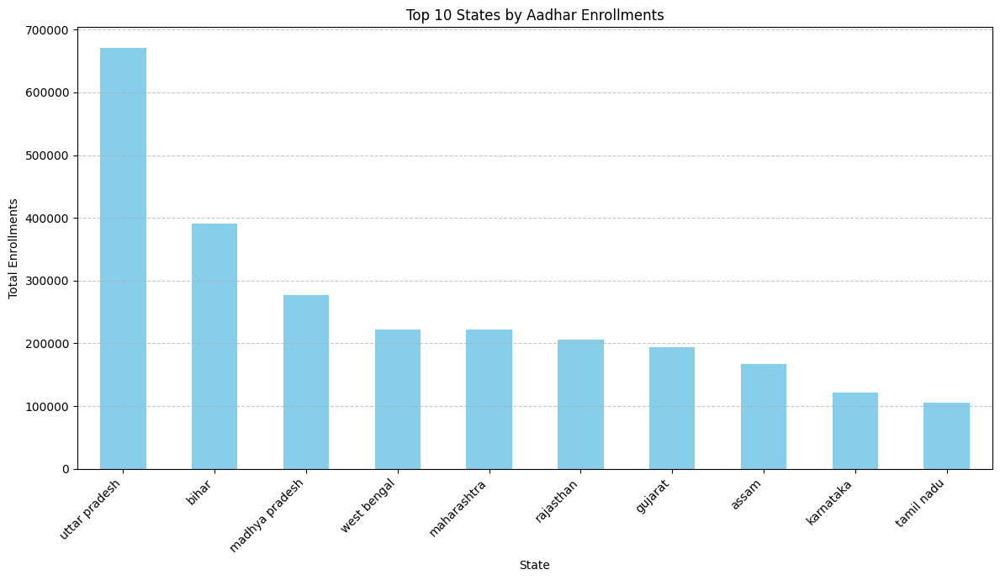

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 7))
top_10_states.plot(kind='bar', color='skyblue')
plt.title('Top 10 States by Aadhar Enrollments')
plt.xlabel('State')
plt.ylabel('Total Enrollments')
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

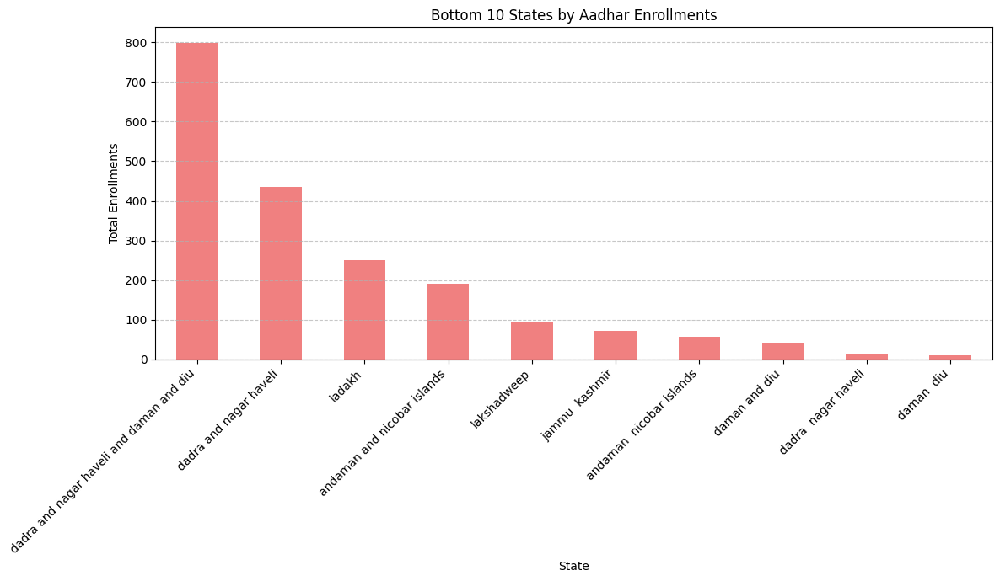

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 7))
bottom_10_states.plot(kind='bar', color='lightcoral')
plt.title('Bottom 10 States by Aadhar Enrollments')
plt.xlabel('State')
plt.ylabel('Total Enrollments')
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

## Analyze Geographical Distribution (Districts)




In [ ]:
df['district'] = df['district'].apply(clean_string)
print("Applied clean_string function to 'state' and 'district' columns.")

Applied clean_string function to 'state' and 'district' columns.


In [ ]:
print(f"Total number of distinct districts: {df['district'].nunique()}")
print("Unique districts and their counts:")
display(df['district'].value_counts())

Total number of distinct districts: 949
Unique districts and their counts:


,count
district,
north 24 parganas,3392
pune,3274
barddhaman,2744
bengaluru,2619
hyderabad,2456
...,...
bandipur,1
mangan,1
leh ladakh,1


In [ ]:
district_enrollments = df.groupby(['state', 'district'])['total_enrollments'].sum().sort_values(ascending=False)
display(district_enrollments.head())
display(district_enrollments.tail())

,,total_enrollments
state,district,
bihar,sitamarhi,34278
uttar pradesh,bahraich,32681
maharashtra,thane,29464
meghalaya,east khasi hills,25873
uttar pradesh,sitapur,23140


,,total_enrollments
state,district,
uttar pradesh,raebareli,1
chhattisgarh,mohallamanpurambagarh chowki,1
tamil nadu,namakkal,1
sikkim,mangan,1
jharkhand,bokaro,1


In [ ]:
top_10_districts = district_enrollments.head(10)
bottom_10_districts = district_enrollments.tail(10)

print("Top 10 Districts by Aadhar Enrollments:")
display(top_10_districts)

print("\nBottom 10 Districts by Aadhar Enrollments:")
display(bottom_10_districts)

Top 10 Districts by Aadhar Enrollments:


,,total_enrollments
state,district,
bihar,sitamarhi,34278
uttar pradesh,bahraich,32681
maharashtra,thane,29464
meghalaya,east khasi hills,25873
uttar pradesh,sitapur,23140
karnataka,bengaluru urban,23074
bihar,west champaran,20974
uttar pradesh,agra,20900
karnataka,bengaluru,20553



Bottom 10 Districts by Aadhar Enrollments:


state           district                    
jammu  kashmir  udhampur                        1
                bandipur                        1
mizoram         hnahthial                       1
chandigarh      rupnagar                        1
jammu  kashmir  srinagar                        1
uttar pradesh   raebareli                       1
chhattisgarh    mohallamanpurambagarh chowki    1
tamil nadu      namakkal                        1
sikkim          mangan                          1
jharkhand       bokaro                          1
Name: total_enrollments, dtype: int64

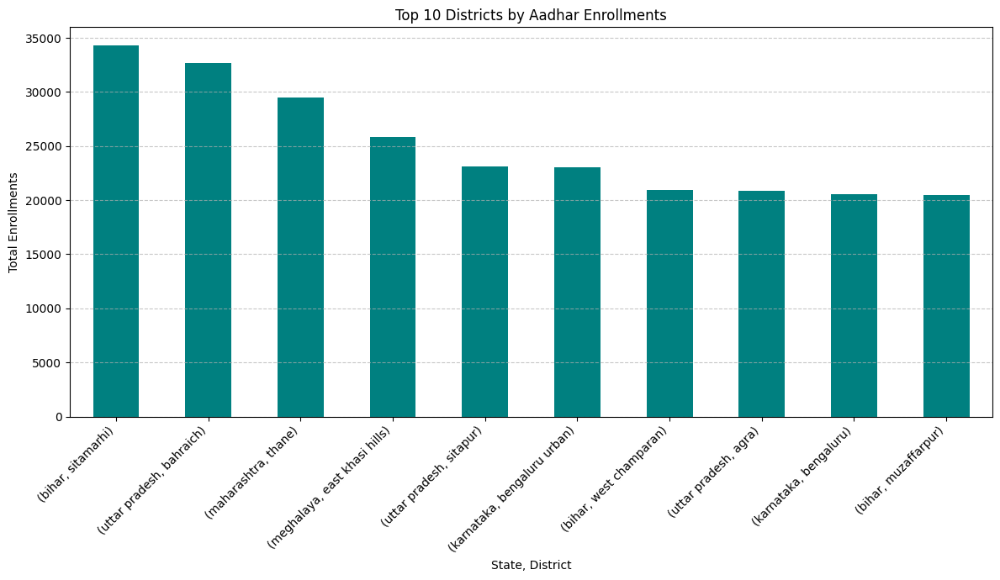

In [ ]:
plt.figure(figsize=(12, 7))
top_10_districts.plot(kind='bar', color='teal')
plt.title('Top 10 Districts by Aadhar Enrollments')
plt.xlabel('State, District')
plt.ylabel('Total Enrollments')
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

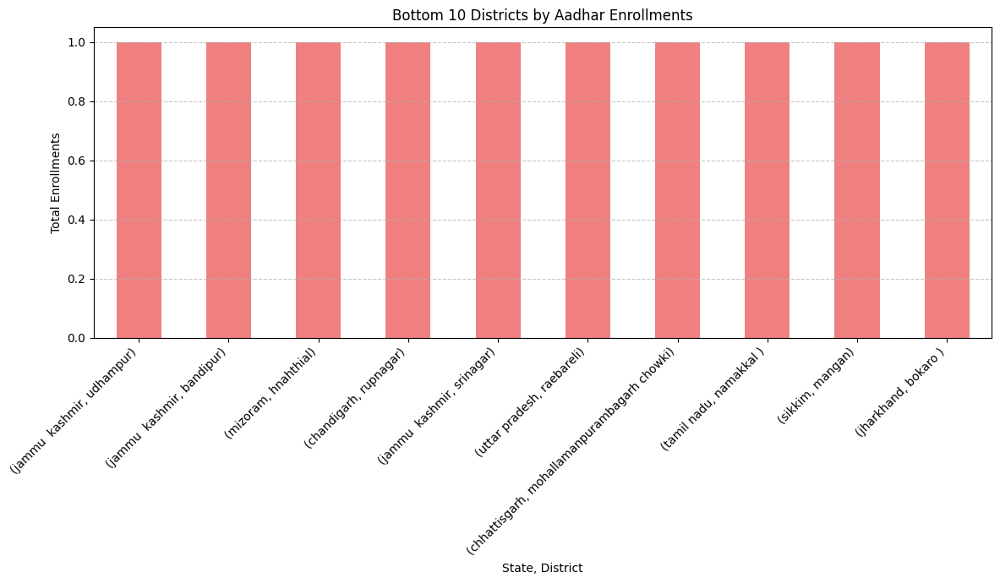

In [ ]:
plt.figure(figsize=(12, 7))
bottom_10_districts.plot(kind='bar', color='lightcoral')
plt.title('Bottom 10 Districts by Aadhar Enrollments')
plt.xlabel('State, District')
plt.ylabel('Total Enrollments')
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

## Summary:

### Data Analysis Key Findings

*   **Data Preparation:**
    *   The 'date' column was successfully converted to datetime objects, enabling time-series analysis.
    *   A new column, 'total\_enrollments', was created by summing age-group specific enrollments, providing a comprehensive view of overall enrollments.
*   **Age Group Distribution:**
    *   The `age_0_5` group accounts for the highest total enrollments with 2,020,406, followed by `age_5_17` with 1,157,841.
    *   The `age_18_greater` group has the lowest enrollments, totaling 122,779. This indicates a strong focus or higher penetration in younger age demographics.
*   **Temporal Trends:**
    *   Monthly total Aadhar enrollments show fluctuations over time, with a general trend that can be observed from the generated line plot, suggesting periods of growth and potential seasonality.
*   **Geographical Distribution (States):**
    *   **Top States:** Uttar Pradesh, Bihar, Madhya Pradesh, West Bengal, and Maharashtra lead in Aadhar enrollments, with Uttar Pradesh alone having 670,426 enrollments.
    *   **Bottom States:** The analysis for states with the lowest enrollments revealed significant data quality issues, including inconsistent naming (e.g., "West Bengal" appearing as 'Westbengal', 'West bengal', 'WEST BENGAL') and an anomalous entry like '100000', with extremely low enrollment counts (e.g., 1 to 12).
*   **Geographical Distribution (Districts):**
    *   **Top Districts:** Sitamarhi (Bihar) with 34,278 enrollments and Bahraich (Uttar Pradesh) with 32,681 are among the districts with the highest Aadhar enrollments.
    *   **Bottom Districts:** Similar to states, several districts across different states (e.g., Hooghiy in West Bengal, Chittoor in Andhra Pradesh) show only 1 enrollment, highlighting potential data inaccuracies or very specific, low-activity regions.

### Insights or Next Steps

*   **Data Quality Improvement:** Prioritize cleaning and standardizing geographical names (states and districts) to ensure accurate analysis of regional enrollment performance. This will prevent misaggregation and misinterpretation of data.
*   **Targeted Outreach for Older Demographics:** Investigate the reasons for significantly lower enrollment in the `age_18_greater` group. This could inform targeted campaigns or policy adjustments to increase Aadhar penetration among adults.


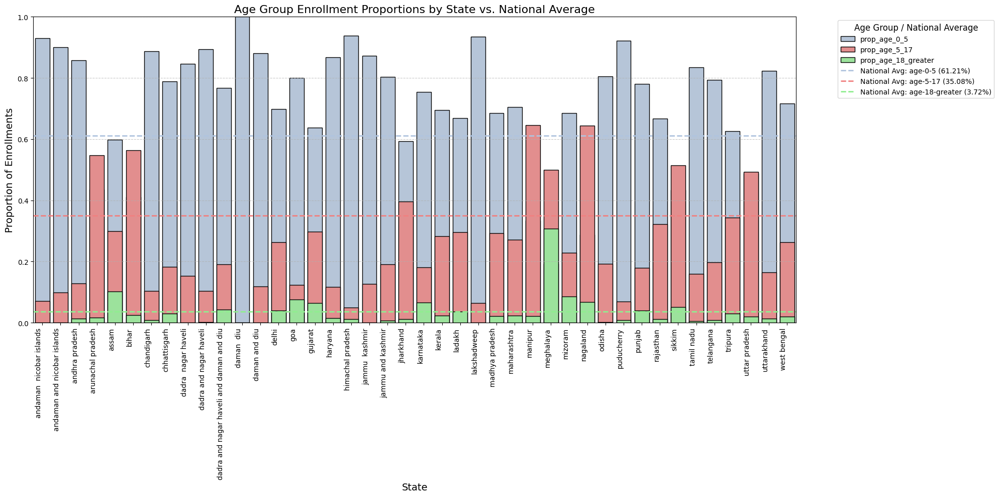

In [ ]:

# calculate state_age_enrollments
if 'state_age_enrollments' not in globals():
    age_group_cols = ['age_0_5', 'age_5_17', 'age_18_greater']
    state_age_enrollments = df.groupby('state')[age_group_cols].sum()
    state_age_enrollments['total_enrollments'] = state_age_enrollments[age_group_cols].sum(axis=1)
    for col in age_group_cols:
        state_age_enrollments[f'prop_{col}'] = state_age_enrollments[col] / state_age_enrollments['total_enrollments']

# Reset index to make 'state' a column for melting
state_age_enrollments_reset = state_age_enrollments.reset_index()

# Melt the DataFrame to long format for easier plotting with seaborn
melted_state_proportions = state_age_enrollments_reset.melt(
    id_vars='state',
    value_vars=[f'prop_{col}' for col in age_group_cols],
    var_name='age_group',
    value_name='proportion'
)

# Define explicit hue order and colors for consistency
hue_order = [f'prop_{col}' for col in age_group_cols]
colors_for_age_groups = {
    'prop_age_0_5': 'lightsteelblue',
    'prop_age_5_17': 'lightcoral',
    'prop_age_18_greater': 'lightgreen'
}

# calculate national_avg_age_proportions
if 'national_avg_age_proportions' not in globals():
    national_age_enrollments = df[age_group_cols].sum()
    grand_total_enrollments = national_age_enrollments.sum()
    national_avg_age_proportions = national_age_enrollments / grand_total_enrollments

plt.figure(figsize=(20, 10))
ax = sns.barplot(
    x='state',
    y='proportion',
    hue='age_group',
    data=melted_state_proportions,
    hue_order=hue_order,
    palette=colors_for_age_groups,
    dodge=False, # For stacked bars
    edgecolor='black'
)

# Add national average lines for comparison
line_handles = []
for age_group_label, color in colors_for_age_groups.items():
    original_age_group = age_group_label.replace('prop_', '')
    if original_age_group in national_avg_age_proportions.index: # Check if index exists
        national_avg_value = national_avg_age_proportions[original_age_group]
        line = ax.axhline(national_avg_value, color=color, linestyle='--', linewidth=2,
                          label=f'National Avg: {original_age_group.replace("_", "-")} ({national_avg_value:.2%})')
        line_handles.append(line)

# Combine the default legend from seaborn with the custom line legend
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles=handles, labels=labels, title='Age Group / National Average',
          bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=10, title_fontsize=12)

plt.title('Age Group Enrollment Proportions by State vs. National Average', fontsize=16)
plt.xlabel('State', fontsize=14)
plt.ylabel('Proportion of Enrollments', fontsize=14)
plt.xticks(rotation=90, ha='right', fontsize=10)
plt.yticks(fontsize=10)
plt.ylim(0, 1) # Proportions are between 0 and 1
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

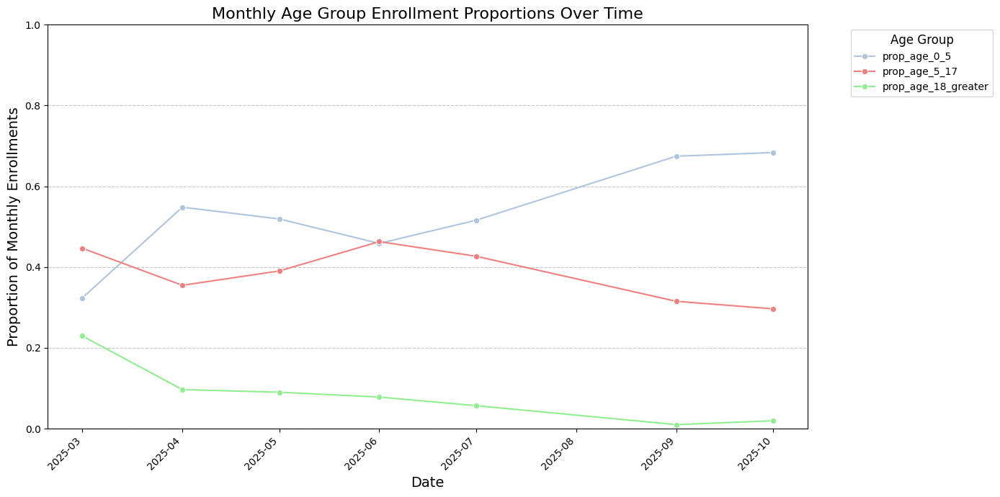

In [ ]:
# Group by year and month to get monthly enrollments for each age group
monthly_age_enrollments = df.groupby(['year', 'month'])[age_group_cols].sum().reset_index()

# Create a 'date' column for plotting
monthly_age_enrollments['date'] = pd.to_datetime(monthly_age_enrollments['year'].astype(str) + '-' + monthly_age_enrollments['month'].astype(str) + '-01')
monthly_age_enrollments = monthly_age_enrollments.sort_values(by='date')

# Calculate total monthly enrollments
monthly_age_enrollments['total_monthly_enrollments'] = monthly_age_enrollments[age_group_cols].sum(axis=1)

# Calculate monthly proportions for each age group
for col in age_group_cols:
    monthly_age_enrollments[f'prop_{col}'] = monthly_age_enrollments[col] / monthly_age_enrollments['total_monthly_enrollments']

# Melt the DataFrame to long format for easier plotting with seaborn
melted_monthly_proportions = monthly_age_enrollments.melt(
    id_vars='date',
    value_vars=[f'prop_{col}' for col in age_group_cols],
    var_name='age_group',
    value_name='proportion'
)

plt.figure(figsize=(14, 7))
sns.lineplot(
    x='date',
    y='proportion',
    hue='age_group',
    data=melted_monthly_proportions,
    palette=colors_for_age_groups,
    marker='o' # Add markers for clarity on sparse data
)

plt.title('Monthly Age Group Enrollment Proportions Over Time', fontsize=16)
plt.xlabel('Date', fontsize=14)
plt.ylabel('Proportion of Monthly Enrollments', fontsize=14)
plt.xticks(rotation=45, ha='right', fontsize=10)
plt.yticks(fontsize=10)
plt.ylim(0, 1) # Proportions are between 0 and 1
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.legend(title='Age Group', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=10, title_fontsize=12)
plt.tight_layout()
plt.show()

### Concentration of Aadhar Applications in Districts

In [ ]:
# Calculate total enrollments per district
district_enrollment_counts = df.groupby('district')['total_enrollments'].sum().sort_values(ascending=False).reset_index()

# Calculate cumulative sum and percentage
district_enrollment_counts['cumulative_enrollments'] = district_enrollment_counts['total_enrollments'].cumsum()
total_overall_enrollments = district_enrollment_counts['total_enrollments'].sum()
district_enrollment_counts['cumulative_percentage'] = (district_enrollment_counts['cumulative_enrollments'] / total_overall_enrollments) * 100

display(district_enrollment_counts.head(10))

# Find the number of districts accounting for a certain percentage (e.g., 50%)

percentage_threshold = 50
districts_for_percentage = district_enrollment_counts[district_enrollment_counts['cumulative_percentage'] <= percentage_threshold]

print(f"\nNumber of districts accounting for the first {percentage_threshold}% of total enrollments: {len(districts_for_percentage)}")
print(f"The top {len(districts_for_percentage)} districts account for approximately {districts_for_percentage['cumulative_percentage'].iloc[-1]:.2f}% of all Aadhar applications.")


,district,total_enrollments,cumulative_enrollments,cumulative_percentage
0,sitamarhi,34278,34278,1.038409
1,bahraich,32681,66959,2.028438
2,thane,29464,96423,2.921012
3,east khasi hills,25873,122296,3.704802
4,sitapur,23140,145436,4.405799
5,bengaluru urban,23074,168510,5.104797
6,west champaran,20974,189484,5.740177
7,agra,20900,210384,6.373316
8,bengaluru,20553,230937,6.995943
9,muzaffarpur,20458,251395,7.615693



Number of districts accounting for the first 50% of total enrollments: 124
The top 124 districts account for approximately 49.82% of all Aadhar applications.


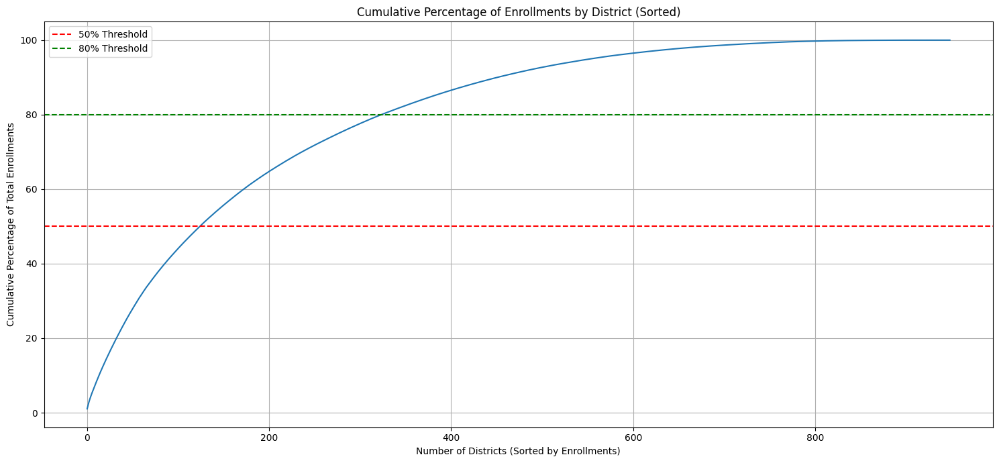

In [ ]:
plt.figure(figsize=(15, 7))
sns.lineplot(x=district_enrollment_counts.index, y='cumulative_percentage', data=district_enrollment_counts)
plt.title('Cumulative Percentage of Enrollments by District (Sorted)')
plt.xlabel('Number of Districts (Sorted by Enrollments)')
plt.ylabel('Cumulative Percentage of Total Enrollments')
plt.grid(True)
plt.axhline(y=50, color='r', linestyle='--', label='50% Threshold')
plt.axhline(y=80, color='g', linestyle='--', label='80% Threshold')
plt.legend()
plt.tight_layout()
plt.show()

### Concentration of Aadhar Applications in Months

In [ ]:
# Calculate total enrollments per month
monthly_enrollments_sorted = monthly_enrollments.sort_values(by='total_enrollments', ascending=False).reset_index(drop=True)

# Calculate cumulative sum and percentage
monthly_enrollments_sorted['cumulative_enrollments'] = monthly_enrollments_sorted['total_enrollments'].cumsum()
total_overall_enrollments_monthly = monthly_enrollments_sorted['total_enrollments'].sum()
monthly_enrollments_sorted['cumulative_percentage'] = (monthly_enrollments_sorted['cumulative_enrollments'] / total_overall_enrollments_monthly) * 100

display(monthly_enrollments_sorted.head())

# Find the number of months accounting for a certain percentage (e.g., 50%)
percentage_threshold = 50
months_for_percentage = monthly_enrollments_sorted[monthly_enrollments_sorted['cumulative_percentage'] <= percentage_threshold]

print(f"\nNumber of months accounting for the first {percentage_threshold}% of total enrollments: {len(months_for_percentage)}")
print(f"The top {len(months_for_percentage)} months account for approximately {months_for_percentage['cumulative_percentage'].iloc[-1]:.2f}% of all Aadhar applications.")


,year,month,total_enrollments,date,cumulative_enrollments,cumulative_percentage
0,2025,9,1475867,2025-09-01,1475867,44.709518
1,2025,7,616868,2025-07-01,2092735,63.396751
2,2025,10,534908,2025-10-01,2627643,79.601110
3,2025,4,257438,2025-04-01,2885081,87.399868
4,2025,6,215734,2025-06-01,3100815,93.935256



Number of months accounting for the first 50% of total enrollments: 1
The top 1 months account for approximately 44.71% of all Aadhar applications.


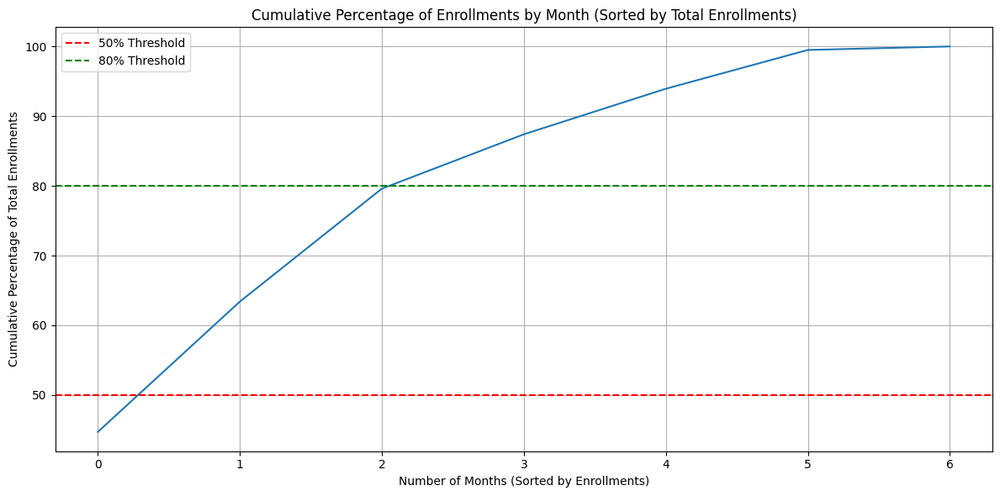

In [ ]:
plt.figure(figsize=(12, 6))
sns.lineplot(x=monthly_enrollments_sorted.index, y='cumulative_percentage', data=monthly_enrollments_sorted)
plt.title('Cumulative Percentage of Enrollments by Month (Sorted by Total Enrollments)')
plt.xlabel('Number of Months (Sorted by Enrollments)')
plt.ylabel('Cumulative Percentage of Total Enrollments')
plt.grid(True)
plt.axhline(y=50, color='r', linestyle='--', label='50% Threshold')
plt.axhline(y=80, color='g', linestyle='--', label='80% Threshold')
plt.legend()
plt.tight_layout()
plt.show()

In [ ]:
district_monthly_enrollments = df.groupby(['district', 'year', 'month'])['total_enrollments'].sum().reset_index()
district_monthly_enrollments['date'] = pd.to_datetime(district_monthly_enrollments['year'].astype(str) + '-' + district_monthly_enrollments['month'].astype(str) + '-01')
display(district_monthly_enrollments.head())

,district,year,month,total_enrollments,date
0,24 paraganas north,2025,6,1050,2025-06-01
1,24 paraganas north,2025,7,5097,2025-07-01
2,24 paraganas south,2025,7,490,2025-07-01
3,adilabad,2025,9,1865,2025-09-01
4,adilabad,2025,10,683,2025-10-01


In [ ]:
district_month_matrix = district_monthly_enrollments.pivot_table(
    index='district',
    columns='date',
    values='total_enrollments'
).fillna(0) # Fill NaN values with 0 for districts with no enrollments in certain months

print("District-Month Enrollment Matrix:")
display(district_month_matrix.head())

District-Month Enrollment Matrix:


date,2025-03-01,2025-04-01,2025-05-01,2025-06-01,2025-07-01,2025-09-01,2025-10-01
district,,,,,,,
24 paraganas north,0.0,0.0,0.0,1050.0,5097.0,0.0,0.0
24 paraganas south,0.0,0.0,0.0,0.0,490.0,0.0,0.0
adilabad,0.0,0.0,0.0,0.0,0.0,1865.0,683.0
agar malwa,0.0,0.0,0.0,0.0,0.0,583.0,169.0
agra,906.0,1437.0,2577.0,3789.0,4569.0,5764.0,1858.0


In [ ]:
top_10_hotspots = district_monthly_enrollments.sort_values(by='total_enrollments', ascending=False).head(10)

print("Top 10 District-Month Enrollment Hotspots:")
display(top_10_hotspots)

Top 10 District-Month Enrollment Hotspots:


,district,year,month,total_enrollments,date
1802,murshidabad,2025,9,13877,2025-09-01
331,bengaluru urban,2025,7,12219,2025-07-01
1946,north 24 parganas,2025,9,10642,2025-09-01
180,bahraich,2025,7,10547,2025-07-01
330,bengaluru urban,2025,6,10123,2025-06-01
2058,pashchim champaran,2025,7,9642,2025-07-01
2507,south 24 parganas,2025,9,9459,2025-09-01
217,banas kantha,2025,7,9228,2025-07-01
1143,jaipur,2025,9,9131,2025-09-01
2464,sitamarhi,2025,7,9117,2025-07-01


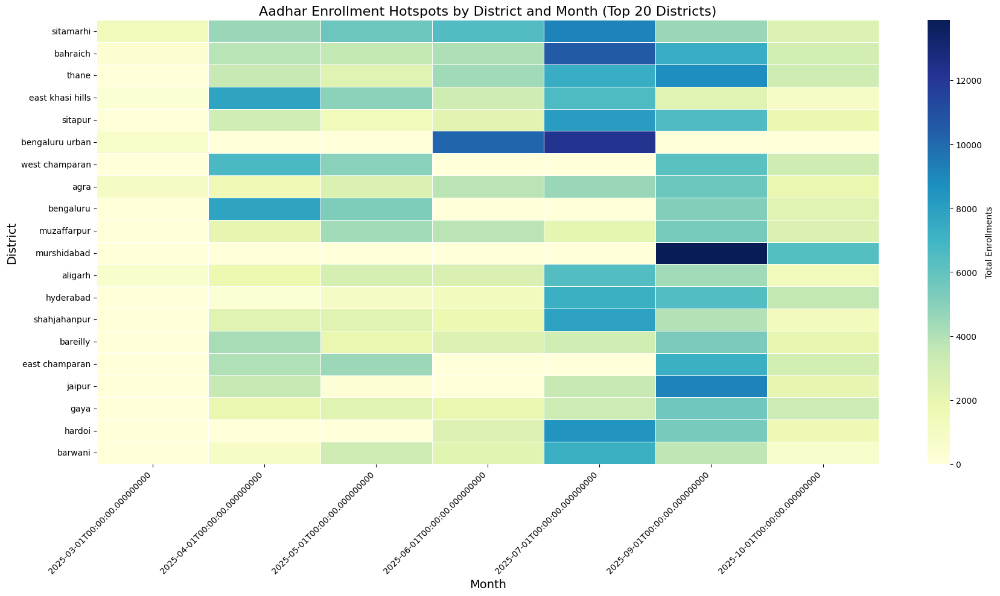

In [ ]:
# Calculate overall enrollments per district to identify top districts for the heatmap
district_enrollments_overall = district_monthly_enrollments.groupby('district')['total_enrollments'].sum().sort_values(ascending=False)
top_n_districts = district_enrollments_overall.head(20).index.tolist()

# Filter the district_month_matrix to include only the top N districts
filtered_district_month_matrix = district_month_matrix.loc[top_n_districts]

plt.figure(figsize=(18, 10)) # Adjust figure size for better readability
sns.heatmap(filtered_district_month_matrix, cmap='YlGnBu', fmt='g', linewidths=.5, cbar_kws={'label': 'Total Enrollments'})
plt.title('Aadhar Enrollment Hotspots by District and Month (Top 20 Districts)', fontsize=16)
plt.xlabel('Month', fontsize=14)
plt.ylabel('District', fontsize=14)
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

In [ ]:
minimal_enrollment_districts = district_enrollment_counts[district_enrollment_counts['total_enrollments'].isin([1, 2])]

print("Districts with 1 or 2 total enrollments (potential data anomalies):")
display(minimal_enrollment_districts)

Districts with 1 or 2 total enrollments (potential data anomalies):


,district,total_enrollments,cumulative_enrollments,cumulative_percentage
924,burdwan,2,3300985,99.999152
925,north east,2,3300987,99.999212
926,saitual,2,3300989,99.999273
927,kushinagar,2,3300991,99.999334
928,deeg,2,3300993,99.999394
929,east midnapur,1,3300994,99.999424
930,west medinipur,1,3300995,99.999455
931,raebareli,1,3300996,99.999485
932,hnahthial,1,3300997,99.999515
933,nicobars,1,3300998,99.999546


In [ ]:
print("All Monthly Enrollments Sorted (highest to lowest):")
display(monthly_enrollments_sorted)

print("\nTop 5 Months by Total Enrollments:")
display(monthly_enrollments_sorted.head(5))

print("\nBottom 5 Months by Total Enrollments:")
display(monthly_enrollments_sorted.tail(5))

All Monthly Enrollments Sorted (highest to lowest):


,year,month,total_enrollments,date,cumulative_enrollments,cumulative_percentage
0,2025,9,1475867,2025-09-01,1475867,44.709518
1,2025,7,616868,2025-07-01,2092735,63.396751
2,2025,10,534908,2025-10-01,2627643,79.601110
3,2025,4,257438,2025-04-01,2885081,87.399868
4,2025,6,215734,2025-06-01,3100815,93.935256
5,2025,5,183616,2025-05-01,3284431,99.497669
6,2025,3,16582,2025-03-01,3301013,100.000000



Top 5 Months by Total Enrollments:


,year,month,total_enrollments,date,cumulative_enrollments,cumulative_percentage
0,2025,9,1475867,2025-09-01,1475867,44.709518
1,2025,7,616868,2025-07-01,2092735,63.396751
2,2025,10,534908,2025-10-01,2627643,79.601110
3,2025,4,257438,2025-04-01,2885081,87.399868
4,2025,6,215734,2025-06-01,3100815,93.935256



Bottom 5 Months by Total Enrollments:


,year,month,total_enrollments,date,cumulative_enrollments,cumulative_percentage
2,2025,10,534908,2025-10-01,2627643,79.601110
3,2025,4,257438,2025-04-01,2885081,87.399868
4,2025,6,215734,2025-06-01,3100815,93.935256
5,2025,5,183616,2025-05-01,3284431,99.497669
6,2025,3,16582,2025-03-01,3301013,100.000000


In [ ]:
print("National Average Age Group Proportions:")
display(national_avg_age_proportions)

National Average Age Group Proportions:


,0
age_0_5,0.612056
age_5_17,0.350753
age_18_greater,0.037191


In [ ]:
selected_outlier_states = ['meghalaya', 'andaman and nicobar islands']

# Filter the state_age_enrollments DataFrame for the selected outlier states
outlier_states_data = state_age_enrollments.loc[selected_outlier_states]

# Calculate proportions for these states
outlier_proportions = pd.DataFrame(index=outlier_states_data.index)
for col in age_group_cols:
    outlier_proportions[f'prop_{col}'] = outlier_states_data[col] / outlier_states_data['total_enrollments']

print("Age Group Proportions for Selected Outlier States:")
display(outlier_proportions)

Age Group Proportions for Selected Outlier States:


,prop_age_0_5,prop_age_5_17,prop_age_18_greater
state,,,
meghalaya,0.193230,0.498971,0.307799
andaman and nicobar islands,0.900524,0.099476,0.000000


In [ ]:
# Step 1: Install Git if not already
!apt-get install git

# Step 2: Configure your GitHub identity
!git config --global user.email "your_email@example.com"
!git config --global user.name "YourGitHubUsername"

# Step 3: Clone your repo
!git clone https://github.com/MariaKhan28981/UIDAI-hackathon-project.git

# Step 4: Move your notebook into the repo folder
!cp /content/AadharDataAnalysis.ipynb /content/UIDAI-hackathon-project/

# Step 5: Commit and push
%cd /content/UIDAI-hackathon-project
!git add AadharDataAnalysis.ipynb
!git commit -m "Added notebook from Colab"
!git push
